In [2]:
%matplotlib inline

In [3]:
!pip install -q tensorflow-gpu==2.0.0-beta1

import glob
import os
import re
import time

import matplotlib.pyplot as plt
import tensorflow as tf

from IPython.display import clear_output

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
    raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [4]:
# https://github.com/tensorflow/tensorflow/issues/1578#issuecomment-200544189
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

In [5]:
# Set these to be the directories containing the data subdirectories
# (so xzIntensity and OMAG BScans are 2 levels down from this dir).
TRAIN_DATA_DIR = './train'
TEST_DATA_DIR = './test'

# Shuffle buffer size (>= dataset size for perfect shuffling)
BUFFER_SIZE = 400

# This should actually be much more but also that will blow up the RAM
EPOCHS = 100

In [6]:
def resize(input_image, real_image, height, width):
    input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

    return input_image, real_image

In [7]:
def random_crop(input_image, real_image):
    stacked_image = tf.stack([input_image, real_image], axis=0)
    cropped_image = tf.image.random_crop(
      stacked_image, size=[2, 256, 256, 1])

    return cropped_image[0], cropped_image[1]

In [8]:
@tf.function()
def random_jitter(input_image, real_image, use_random_jitter):
    if use_random_jitter:
        # resizing to 286 x 286
        input_image, real_image = resize(input_image, real_image, 286, 286)

        # randomly cropping to 256 x 256
        input_image, real_image = random_crop(input_image, real_image)

        if tf.random.uniform(()) > 0.5:
            # random mirroring
            input_image = tf.image.flip_left_right(input_image)
            real_image = tf.image.flip_left_right(real_image)
    else:
        # resizing to 256 x 256
        input_image, real_image = resize(input_image, real_image, 256, 256)

    return input_image, real_image

In [9]:
# Decodes a grayscale PNG, returns a 2D tensor.
def load_image(file_name):
    image = tf.io.read_file(file_name)
    image = tf.image.decode_png(image)
    return image

In [10]:
# Returns a pair of tensors containing the given B-scan and its
# corresponding OMAG. |bscan_path| should be in directory 'xzIntensity'
# and its parent directory should contain 'OMAG Bscans'. Scan files
# should be named <num>.png (no leading 0s), with a 4-to-1 ratio of
# B-scans to OMAGs.
# (OMAG Bscans/1.png corresponds to xzIntensity/{1,2,3,4}.png.)
def get_images(bscan_path, use_random_jitter=True):
    bscan_img = load_image(bscan_path)
    
    path_components = re.search(
        r'^(.*)xzIntensity/(\d+)\.png$', bscan_path)
    
    dir_path = path_components.group(1)
    bscan_num = int(path_components.group(2))
    
    omag_num = ((bscan_num - 1) // 4) + 1
    
    omag_img = load_image(
        os.path.join(dir_path, 'OMAG Bscans',
                     '{}.png'.format(omag_num)))
    
    bscan_img = tf.cast(bscan_img, tf.float32)
    omag_img = tf.cast(omag_img, tf.float32)

    bscan_img = (bscan_img / 127.5) - 1
    omag_img = (omag_img / 127.5) - 1

    bscan_img, omag_img = random_jitter(bscan_img, omag_img, use_random_jitter)
    
    return bscan_img, omag_img

def get_images_no_jitter(bscan_path):
    return get_images(bscan_path, False)

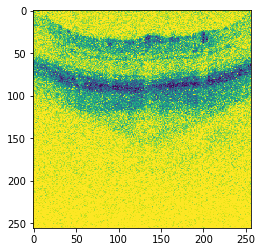

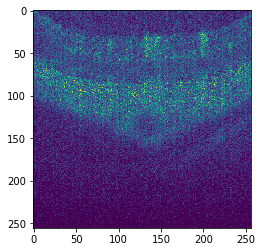

In [11]:
# Test dump input 1 from the '2015-08-11 Images50'
# dataset.

input_img, output_img = get_images(
    os.path.join(TRAIN_DATA_DIR, '2015-08-11 Images50', 'xzIntensity', '1.png'))
    
plt.figure()
plt.imshow(tf.squeeze(input_img))
plt.figure()
plt.imshow(tf.squeeze(output_img))

In [12]:
# Build a tf.data.Dataset of input B-scan and output OMAG images in the given directory.
def get_dataset(data_dir, use_random_jitter=True):
    dataset = tf.data.Dataset.from_generator(
        lambda: map(get_images if use_random_jitter else get_images_no_jitter, glob.glob(
            os.path.join(data_dir, '*', 'xzIntensity', '*.png'))),
        output_types=(tf.float32, tf.float32))
    # silently drop data that causes errors (e.g. corresponding OMAG file doesn't exist)
    dataset = dataset.apply(tf.data.experimental.ignore_errors())
    dataset = dataset.shuffle(BUFFER_SIZE)
    dataset = dataset.batch(1)
    return dataset

train_dataset = get_dataset(TRAIN_DATA_DIR)
test_dataset = get_dataset(TEST_DATA_DIR)

W0711 08:38:42.510051 140355232966464 deprecation.py:323] From /private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/data/ops/dataset_ops.py:505: py_func (from tensorflow.python.ops.script_ops) is deprecated and will be removed in a future version.
Instructions for updating:
tf.py_func is deprecated in TF V2. Instead, there are two
    options available in V2.
    - tf.py_function takes a python function which manipulates tf eager
    tensors instead of numpy arrays. It's easy to convert a tf eager tensor to
    an ndarray (just call tensor.numpy()) but having access to eager tensors
    means `tf.py_function`s can use accelerators such as GPUs as well as
    being differentiable using a gradient tape.
    - tf.numpy_function maintains the semantics of the deprecated tf.py_func
    (it is not differentiable, and manipulates numpy arrays). It drops the
    stateful argument making all functions stateful.
    


In [13]:
print(len(list(test_dataset)))
print(len(list(train_dataset)))

1276
1276


# pix2pix generator

In [14]:
OUTPUT_CHANNELS = 1

def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
            kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

down_model = downsample(3, 1)
down_result = down_model(tf.expand_dims(input_img, 0))
print (down_result.shape)

(1, 128, 128, 3)


In [15]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

up_model = upsample(3, 1)
up_result = up_model(down_result)
print (up_result.shape)

(1, 256, 256, 3)


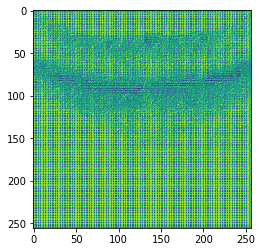

In [16]:
def Generator():
  down_stack = [
    downsample(64, 4, apply_batchnorm=False), # (bs, 128, 128, 64)
    downsample(128, 4), # (bs, 64, 64, 128)
    downsample(256, 4), # (bs, 32, 32, 256)
    downsample(512, 4), # (bs, 16, 16, 512)
    downsample(512, 4), # (bs, 8, 8, 512)
    downsample(512, 4), # (bs, 4, 4, 512)
    downsample(512, 4), # (bs, 2, 2, 512)
    downsample(512, 4), # (bs, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
    upsample(512, 4), # (bs, 16, 16, 1024)
    upsample(256, 4), # (bs, 32, 32, 512)
    upsample(128, 4), # (bs, 64, 64, 256)
    upsample(64, 4), # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (bs, 256, 256, 3)

  concat = tf.keras.layers.Concatenate()

  inputs = tf.keras.layers.Input(shape=[None,None,1])
  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = concat([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

generator = Generator()

gen_output = generator(input_img[tf.newaxis,...], training=False)
plt.imshow(tf.squeeze(gen_output[0,...]))

# pix2pix discriminator

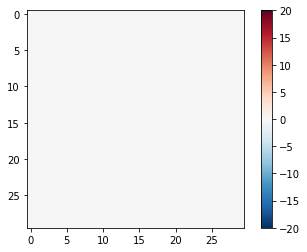

In [17]:
inp = input_img

def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = tf.keras.layers.Input(shape=[None, None, 1], name='input_image')
    tar = tf.keras.layers.Input(shape=[None, None, 1], name='target_image')

    x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

    down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
    down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
    down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

    last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

    return tf.keras.Model(inputs=[inp, tar], outputs=last)

discriminator = Discriminator()
disc_out = discriminator([inp[tf.newaxis,...], gen_output], training=False)
plt.imshow(disc_out[0,...,-1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [18]:
LAMBDA = 100

loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss

generator_optimizer = tf.keras.optimizers.Adam(5e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(5e-4, beta_1=0.5)

# training

In [19]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [20]:
def generate_images(model, test_input, tar):
  # the training=True is intentional here since
  # we want the batch statistics while running the model
  # on the test dataset. If we use training=False, we will get
  # the accumulated statistics learned from the training dataset
  # (which we don't want)
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(tf.squeeze(display_list[i]) * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

In [21]:
@tf.function
def train_step(input_image, target):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_loss,
                                            generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                                discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

In [22]:
def train(dataset, epochs):
    for epoch in range(epochs):
        start = time.time()

        for input_image, target in dataset:
            train_step(input_image, target)

        for inp, tar in test_dataset.take(1):
            generate_images(generator, inp, tar)

        if (epoch + 1) % 15 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        print('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                           time.time() - start))

W0710 17:01:46.442986 139898191009600 deprecation.py:323] From /private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/ops/nn_impl.py:182: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


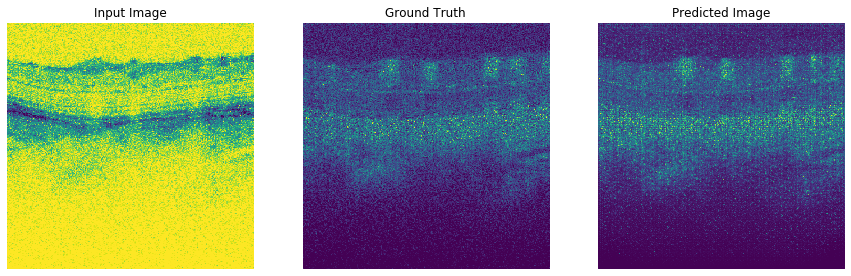

Time taken for epoch 2 is 175.01144361495972 sec



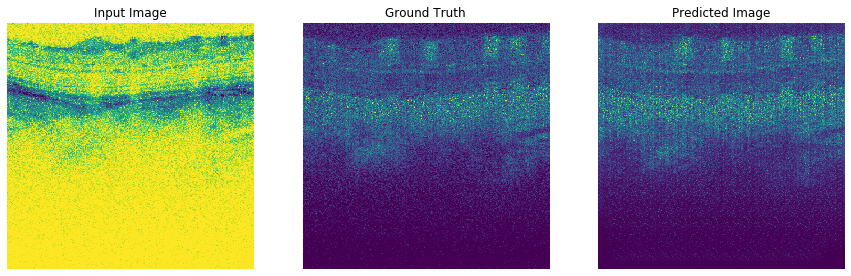

Time taken for epoch 3 is 175.16534423828125 sec



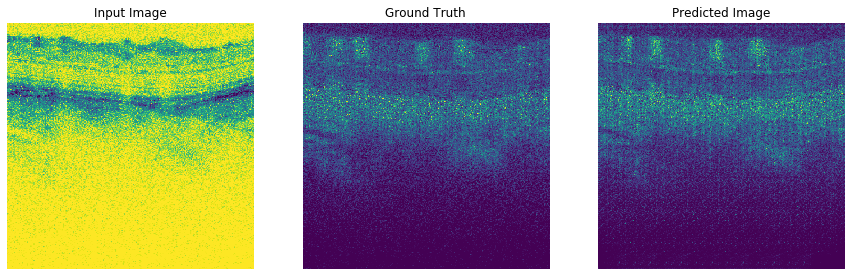

Time taken for epoch 4 is 174.71372866630554 sec



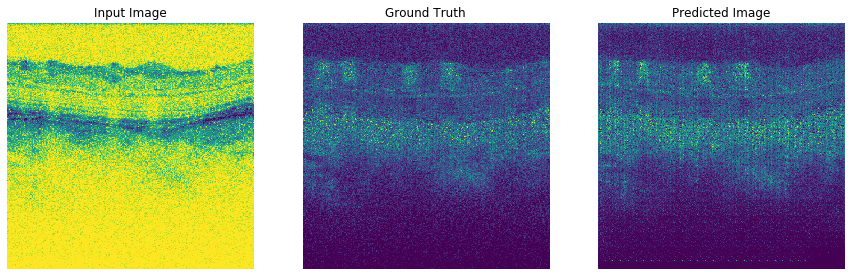

Time taken for epoch 5 is 175.2982361316681 sec



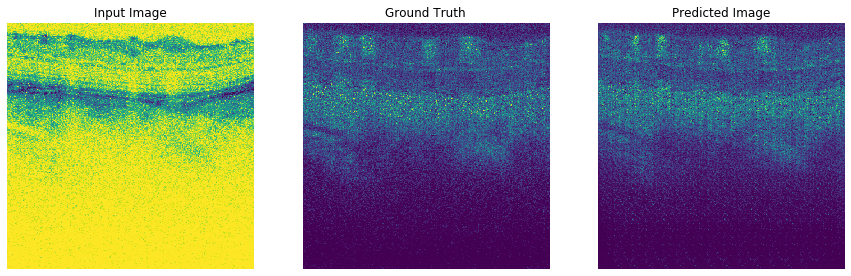

Time taken for epoch 6 is 175.41127252578735 sec



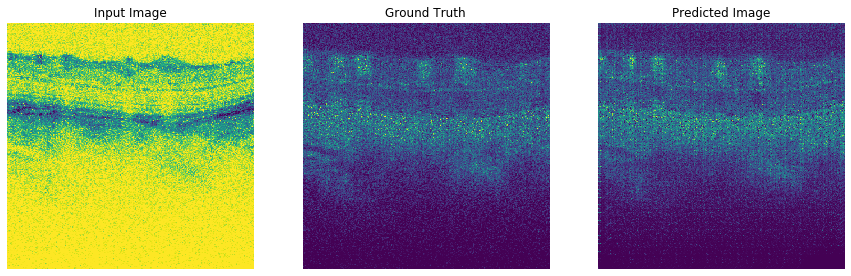

Time taken for epoch 7 is 175.44629001617432 sec



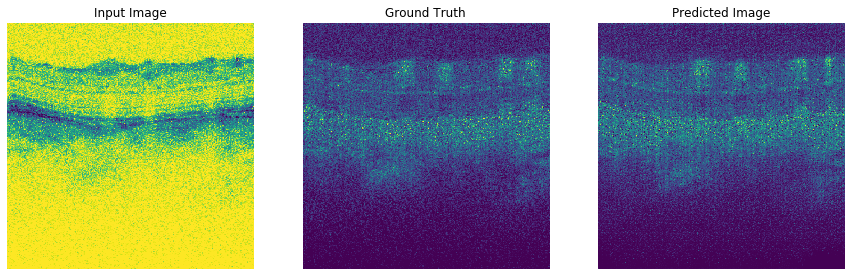

Time taken for epoch 8 is 175.5177059173584 sec



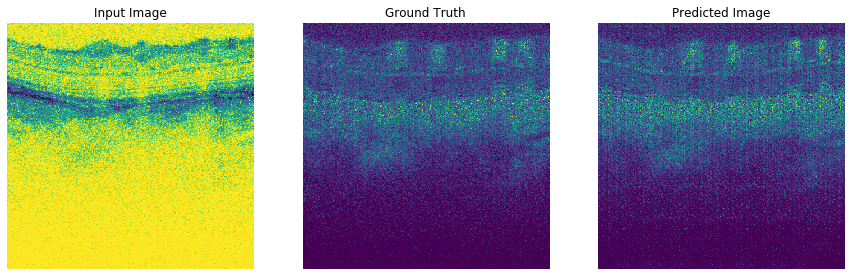

Time taken for epoch 9 is 175.6869261264801 sec



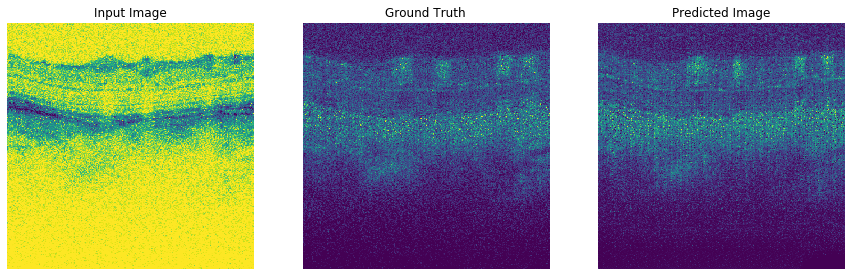

Time taken for epoch 10 is 175.58183336257935 sec



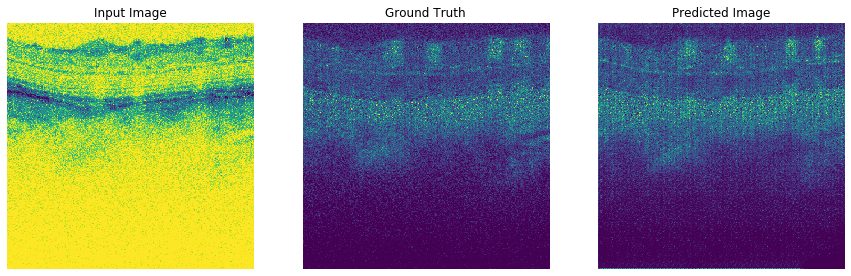

Time taken for epoch 11 is 175.79941940307617 sec



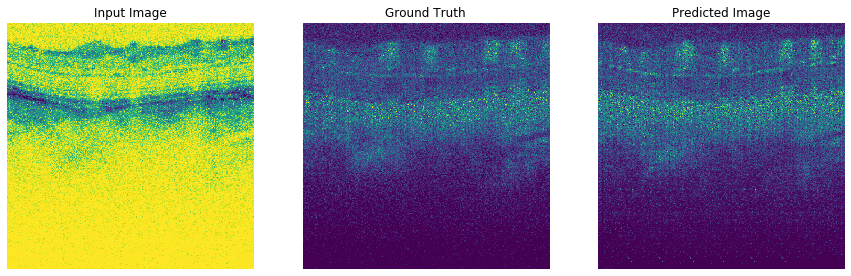

Time taken for epoch 12 is 175.8778212070465 sec



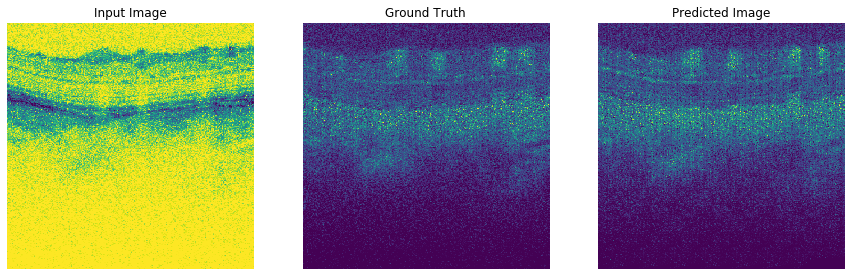

Time taken for epoch 13 is 175.75785064697266 sec



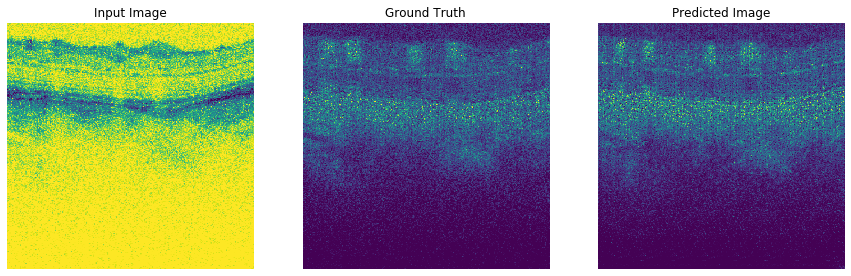

Time taken for epoch 14 is 175.85932636260986 sec



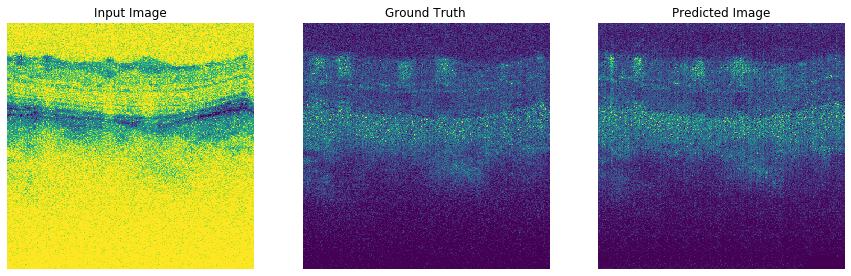

Time taken for epoch 15 is 176.53719425201416 sec



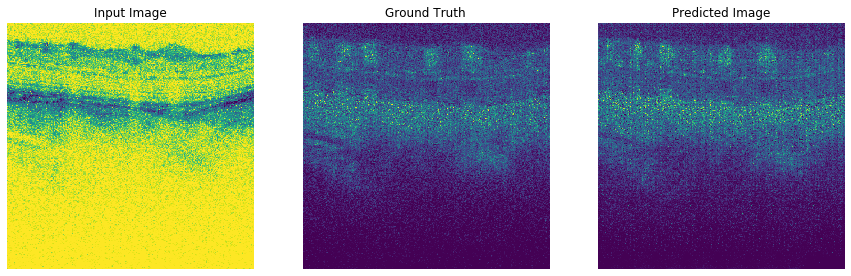

Time taken for epoch 16 is 175.82177209854126 sec



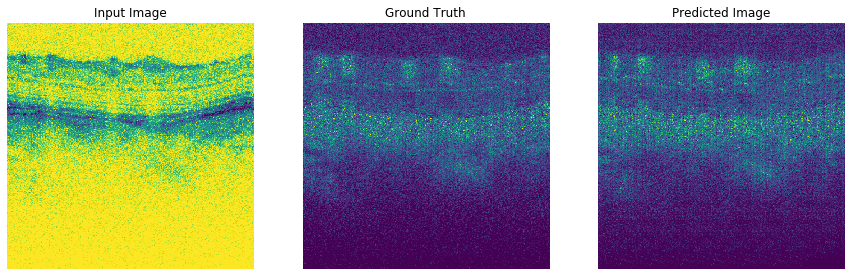

Time taken for epoch 17 is 175.78379321098328 sec



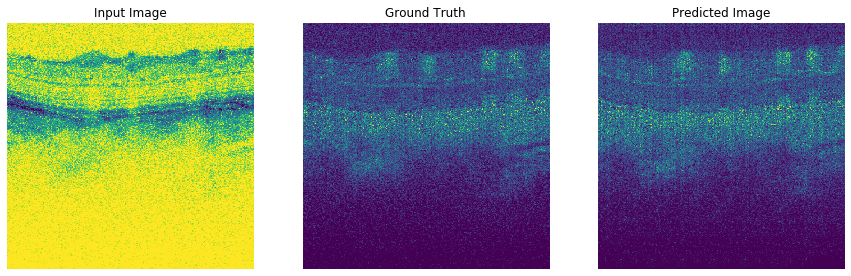

Time taken for epoch 18 is 175.8051245212555 sec



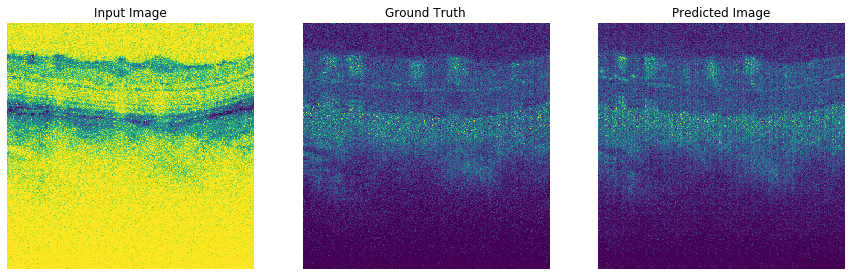

Time taken for epoch 19 is 175.82761931419373 sec



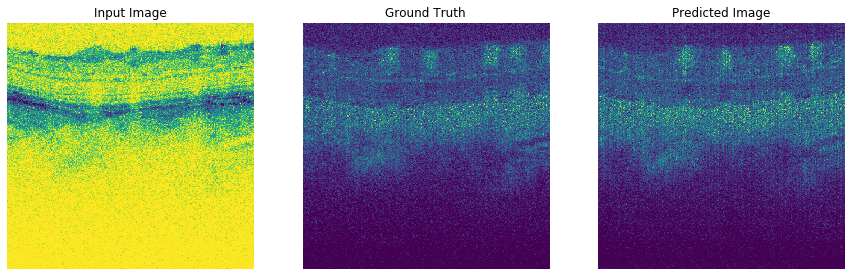

Time taken for epoch 20 is 175.75384306907654 sec



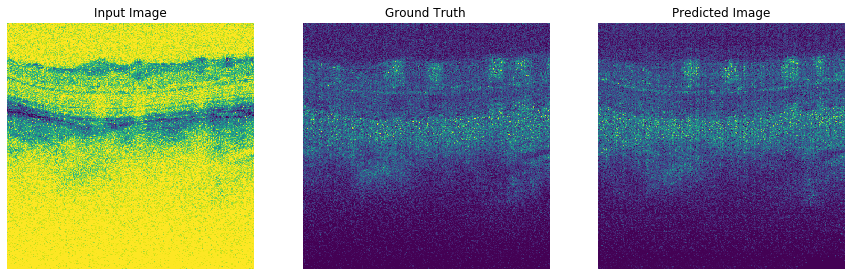

Time taken for epoch 21 is 175.93631029129028 sec



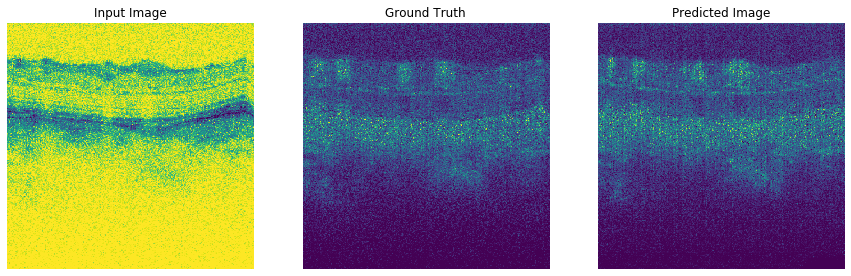

Time taken for epoch 22 is 175.91493892669678 sec



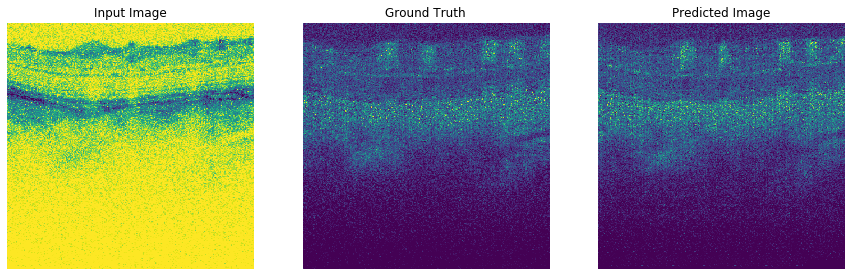

Time taken for epoch 23 is 175.97129678726196 sec



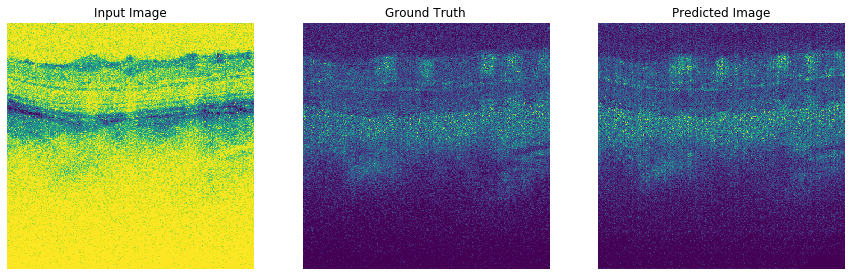

Time taken for epoch 24 is 175.9630205631256 sec



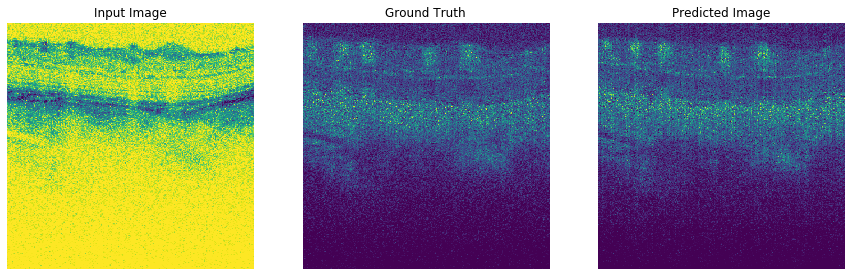

Time taken for epoch 25 is 175.9899616241455 sec



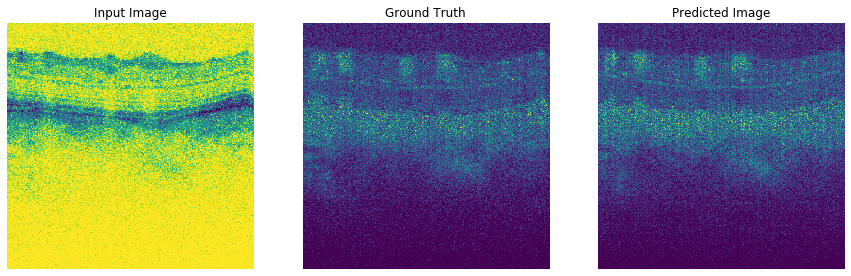

Time taken for epoch 26 is 176.09996461868286 sec



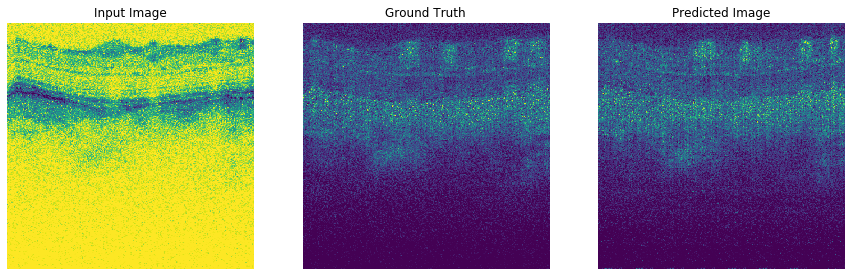

Time taken for epoch 27 is 175.9931070804596 sec



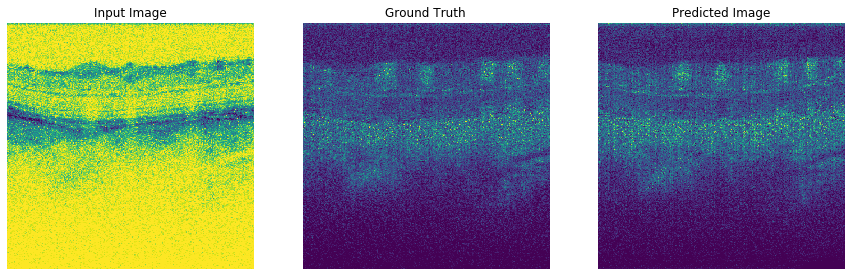

Time taken for epoch 28 is 176.23169589042664 sec



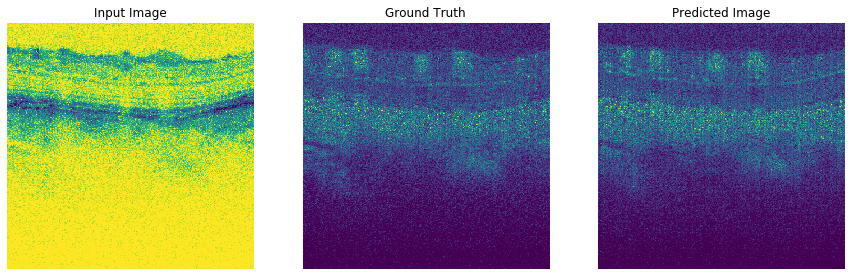

Time taken for epoch 29 is 176.05367136001587 sec



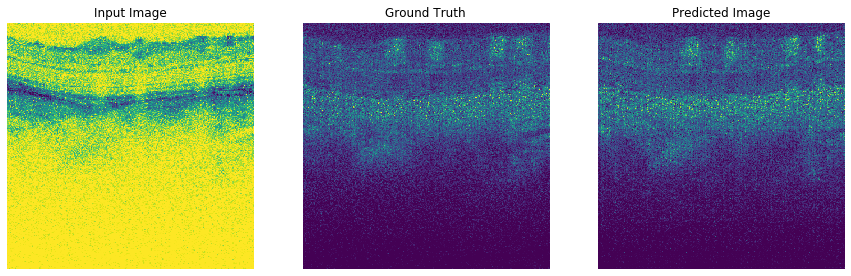

Time taken for epoch 30 is 176.79358792304993 sec



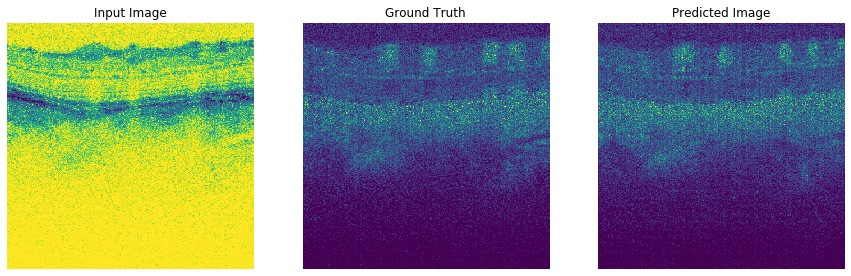

Time taken for epoch 31 is 175.83017897605896 sec



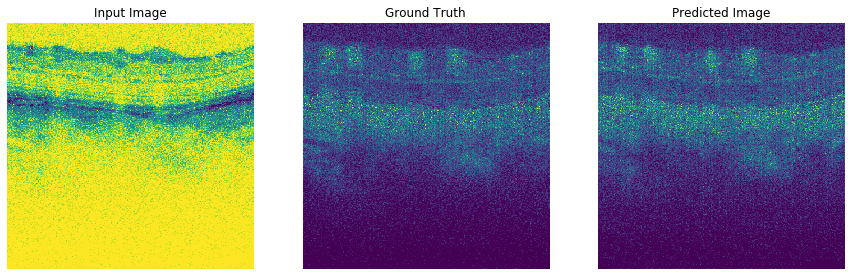

Time taken for epoch 32 is 176.08735966682434 sec



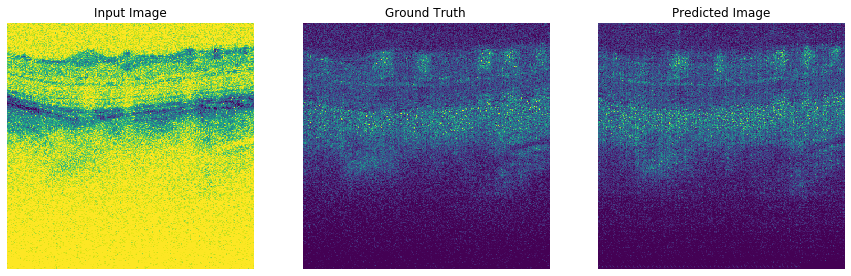

Time taken for epoch 33 is 176.04530501365662 sec



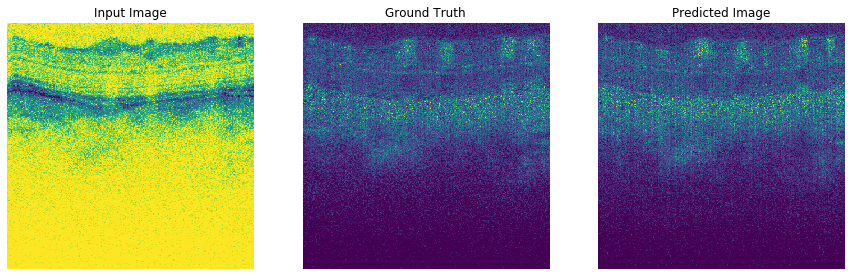

Time taken for epoch 34 is 175.97054934501648 sec



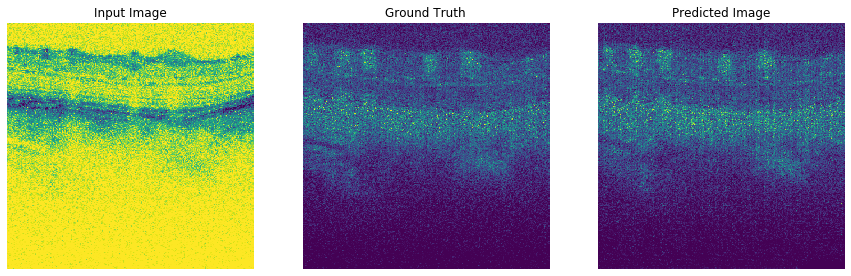

Time taken for epoch 35 is 176.0625491142273 sec



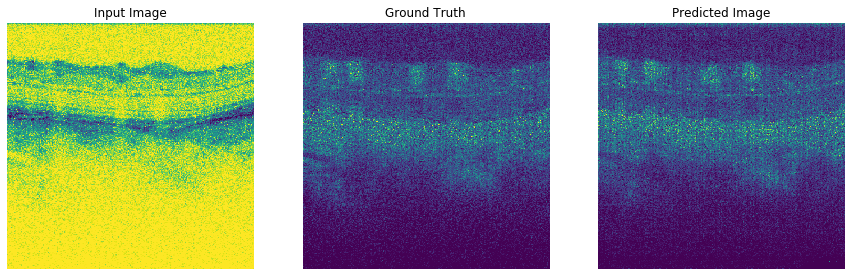

Time taken for epoch 36 is 176.05443024635315 sec



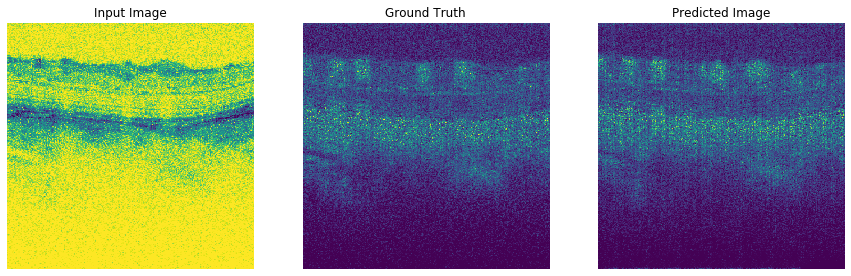

Time taken for epoch 37 is 176.0888819694519 sec



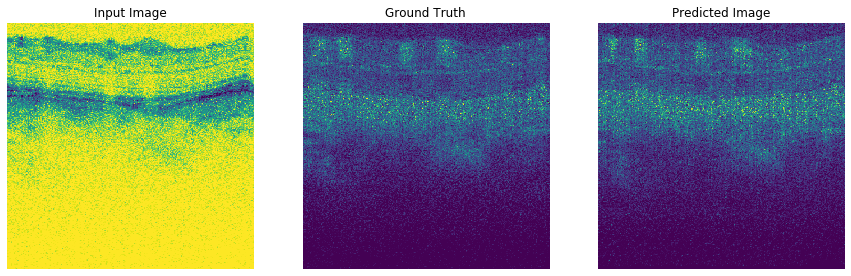

Time taken for epoch 38 is 176.10028386116028 sec



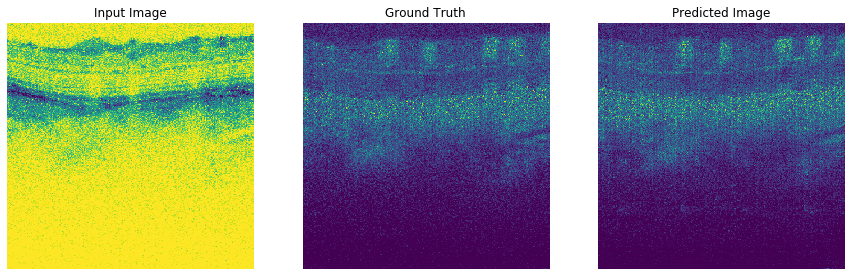

Time taken for epoch 39 is 176.13742804527283 sec



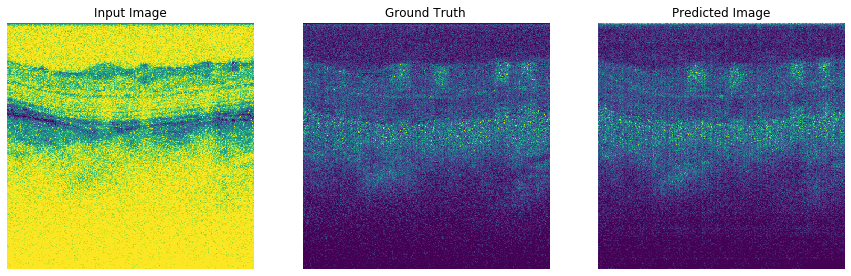

Time taken for epoch 40 is 176.11494755744934 sec



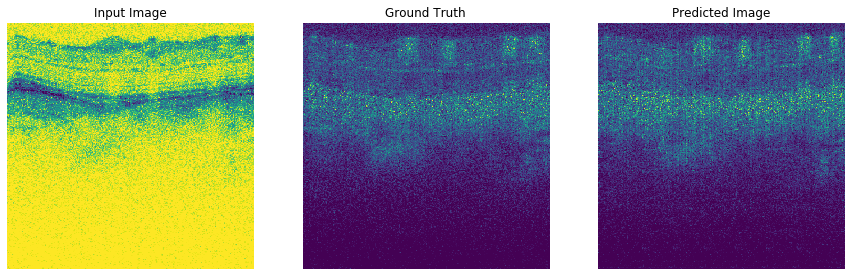

Time taken for epoch 41 is 176.0616569519043 sec



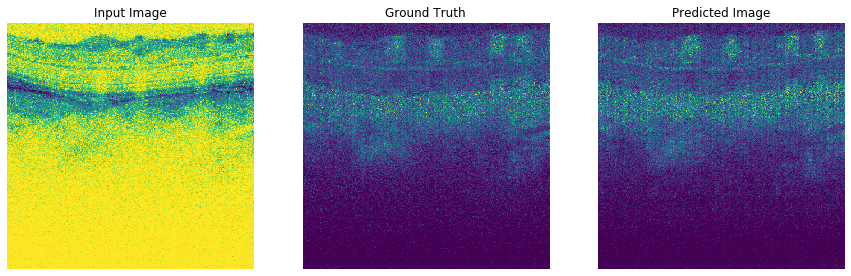

Time taken for epoch 42 is 176.1155505180359 sec



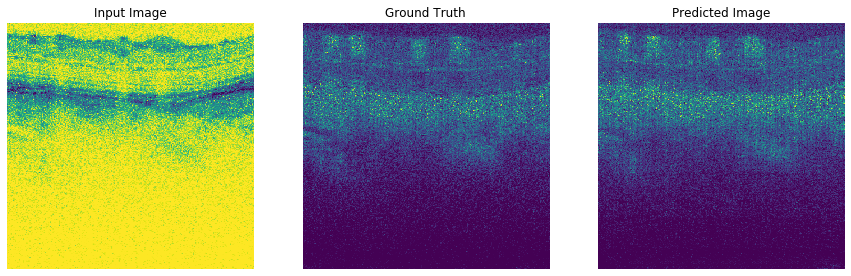

Time taken for epoch 43 is 176.07299184799194 sec



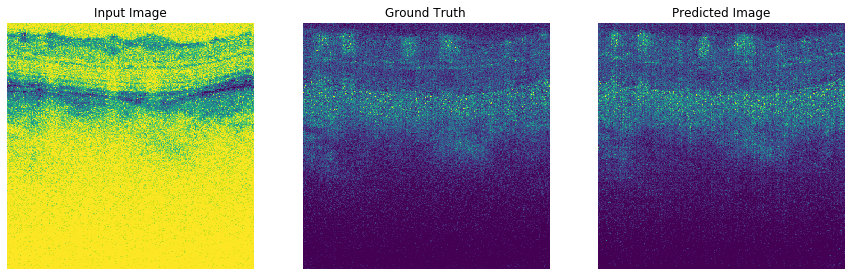

Time taken for epoch 44 is 176.05063033103943 sec



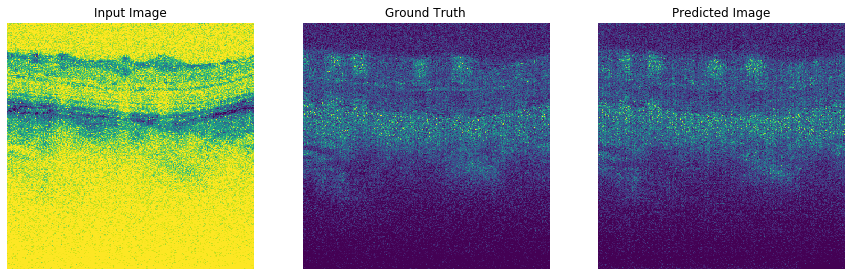

Time taken for epoch 45 is 176.8229784965515 sec



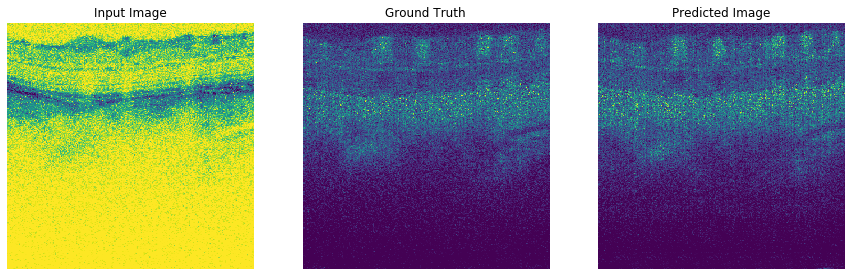

Time taken for epoch 46 is 176.11030507087708 sec



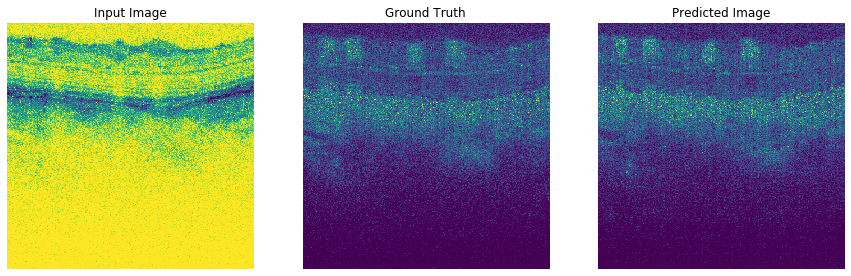

Time taken for epoch 47 is 176.30470776557922 sec



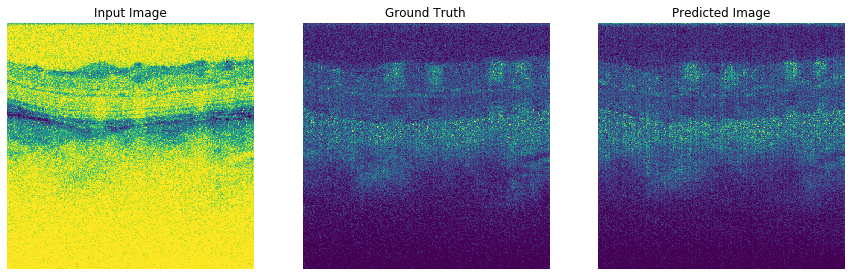

Time taken for epoch 48 is 176.18664860725403 sec



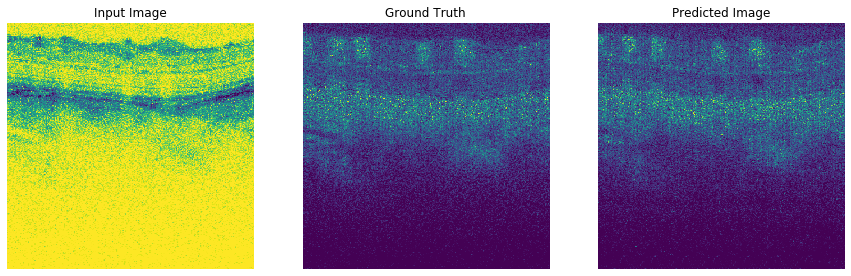

Time taken for epoch 49 is 176.1579942703247 sec



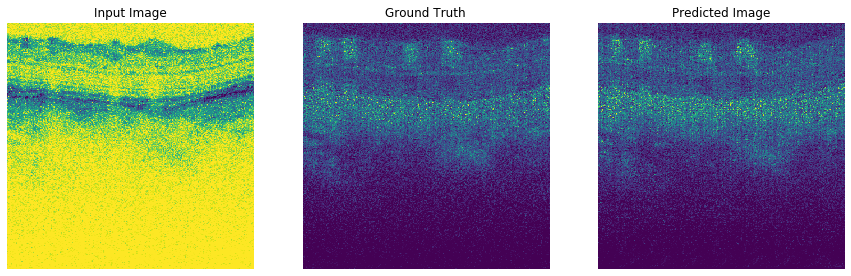

Time taken for epoch 50 is 176.08417129516602 sec



In [ ]:
train(train_dataset, EPOCHS)

In [22]:
!ls {checkpoint_dir}

checkpoint		    ckpt-3.data-00000-of-00002
ckpt-1.data-00000-of-00002  ckpt-3.data-00001-of-00002
ckpt-1.data-00001-of-00002  ckpt-3.index
ckpt-1.index		    ckpt-4.data-00000-of-00002
ckpt-2.data-00000-of-00002  ckpt-4.data-00001-of-00002
ckpt-2.data-00001-of-00002  ckpt-4.index
ckpt-2.index


In [43]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [61]:
# Generate a full set of inferred cross-section PNGs, save them to /predicted/1.png -> /predicted/<N>.png
# where N is the number of input B-scans (so 4 times the number of OMAGs we'd have for this test set).
for i, fn in enumerate(glob.glob(os.path.join(TEST_DATA_DIR, '*', 'xzIntensity', '*.png'))):    
    dataset = tf.data.Dataset.from_generator(
        lambda: map(get_images_no_jitter, [fn]),
        output_types=(tf.float32, tf.float32))
    dataset = dataset.apply(tf.data.experimental.ignore_errors())
    dataset = dataset.batch(1)
    for inp, _ in dataset.take(1):
        pass

    prediction = generator(inp, training=True)
    predicted_img = prediction[0]
    img_to_save = tf.image.encode_png(tf.dtypes.cast((predicted_img * 0.5 + 0.5) * 255, tf.uint8))
    write_op = tf.io.write_file('./predicted/{}.png'.format(
        re.search(r'(\d+)\.png', fn).group(1)
    ), img_to_save)

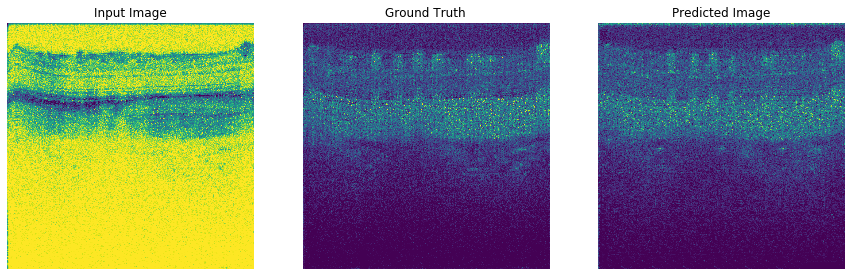

In [44]:
test_dataset = get_dataset(TEST_DATA_DIR, False) # no random jitter please!
for inp, tar in test_dataset.take(1):
    generate_images(generator, inp, tar)

In [40]:
print(len(list(test_dataset)))

InvalidArgumentError: TypeError: An op outside of the function building code is being passed
a "Graph" tensor. It is possible to have Graph tensors
leak out of the function building context by including a
tf.init_scope in your function building code.
For example, the following function will fail:
  @tf.function
  def has_init_scope():
    my_constant = tf.constant(1.)
    with tf.init_scope():
      added = my_constant * 2
The graph tensor has name: args_0:0
Traceback (most recent call last):

  File "/private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/ops/gen_io_ops.py", line 603, in read_file
    name, _ctx._post_execution_callbacks, filename)

tensorflow.python.eager.core._FallbackException: This function does not handle the case of the path where all inputs are not already EagerTensors.


During handling of the above exception, another exception occurred:


Traceback (most recent call last):

  File "/private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/ops/script_ops.py", line 209, in __call__
    ret = func(*args)

  File "/private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/data/ops/dataset_ops.py", line 525, in generator_py_func
    values = next(generator_state.get_iterator(iterator_id))

  File "<ipython-input-10-12c74937ad00>", line 33, in get_images_no_jitter
    return get_images(bscan_path, False)

  File "<ipython-input-10-12c74937ad00>", line 8, in get_images
    bscan_img = load_image(bscan_path)

  File "<ipython-input-9-fe73e5841dfa>", line 3, in load_image
    image = tf.io.read_file(file_name)

  File "/private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/ops/gen_io_ops.py", line 608, in read_file
    filename, name=name, ctx=_ctx)

  File "/private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/ops/gen_io_ops.py", line 657, in read_file_eager_fallback
    attrs=_attrs, ctx=_ctx, name=name)

  File "/private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/eager/execute.py", line 71, in quick_execute
    raise e

  File "/private/fydp1/venv/lib/python3.6/site-packages/tensorflow/python/eager/execute.py", line 61, in quick_execute
    num_outputs)

TypeError: An op outside of the function building code is being passed
a "Graph" tensor. It is possible to have Graph tensors
leak out of the function building context by including a
tf.init_scope in your function building code.
For example, the following function will fail:
  @tf.function
  def has_init_scope():
    my_constant = tf.constant(1.)
    with tf.init_scope():
      added = my_constant * 2
The graph tensor has name: args_0:0


	 [[{{node PyFunc}}]] [Op:IteratorGetNextSync]